### Import the Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
#Ignore all the warnings

import sys
import warnings

if not sys.warnoptions:
    warnings.simplefilter("ignore")

In [3]:
#Libraries for preprocessing

from gensim.parsing.preprocessing import remove_stopwords
import string
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize

In [4]:
import nltk
#nltk.download('punkt')

In [5]:
#Libraries for preprocessing

from gensim.parsing.preprocessing import remove_stopwords
import string
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
#Libraries for vectorisation
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.model_selection import GridSearchCV
#from fuzzywuzzy import fuzz

In [6]:
#Libraries for clustering
from sklearn.cluster import KMeans

In [7]:
import plotly.express as px
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot 
init_notebook_mode(connected = True)

import cufflinks as cf
cf.go_offline()

### Load the Data Set

In [8]:
df= pd.read_excel('Online Retail.xlsx', engine='openpyxl')

In [9]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   InvoiceNo    541909 non-null  object        
 1   StockCode    541909 non-null  object        
 2   Description  540455 non-null  object        
 3   Quantity     541909 non-null  int64         
 4   InvoiceDate  541909 non-null  datetime64[ns]
 5   UnitPrice    541909 non-null  float64       
 6   CustomerID   406829 non-null  float64       
 7   Country      541909 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(4)
memory usage: 33.1+ MB


### Data Cleaning

In [11]:
df.isna().sum()

InvoiceNo           0
StockCode           0
Description      1454
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     135080
Country             0
dtype: int64

In [12]:
df[df['Description'].isna()] #Inspect the null values

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
622,536414,22139,NaN,56,2010-12-01 11:52:00,0.0,NaN,United Kingdom
1970,536545,21134,NaN,1,2010-12-01 14:32:00,0.0,NaN,United Kingdom
1971,536546,22145,NaN,1,2010-12-01 14:33:00,0.0,NaN,United Kingdom
1972,536547,37509,NaN,1,2010-12-01 14:33:00,0.0,NaN,United Kingdom
1987,536549,85226A,NaN,1,2010-12-01 14:34:00,0.0,NaN,United Kingdom
...,...,...,...,...,...,...,...,...
535322,581199,84581,NaN,-2,2011-12-07 18:26:00,0.0,NaN,United Kingdom
535326,581203,23406,NaN,15,2011-12-07 18:31:00,0.0,NaN,United Kingdom
535332,581209,21620,NaN,6,2011-12-07 18:35:00,0.0,NaN,United Kingdom
536981,581234,72817,NaN,27,2011-12-08 10:33:00,0.0,NaN,United Kingdom


In [13]:
df= df.dropna(axis= 0, subset= ['Description'])

In [14]:
df.isna().sum()

InvoiceNo           0
StockCode           0
Description         0
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     133626
Country             0
dtype: int64

In [15]:
#Drop cols with null values
df= df.dropna(axis=1)

In [16]:
#Check and delete the duplicate rows

df.duplicated().sum()

5268

In [17]:
# removing the duplicate rows

df = df[~df.duplicated()]
df.shape

(535187, 7)

In [18]:
# Trans that have negative quantity which indicates returned or cancelled orders

#df[df['InvoiceNo'].str.startswith('C')==True]

In [19]:
# removing all the invoice number who starts with 'C' as they are returned orders
df = df[df['InvoiceNo'].str.startswith('C')!=True]
df.shape

(525936, 7)

In [20]:
#Check for negative quantity which indicates returned or cancelled order

#df[df['Quantity']<0]

In [21]:
df= df[df['Quantity']>=0]
df.shape

(525462, 7)

In [22]:
df = df[df["StockCode"].apply(lambda x: str(x).isnumeric())]

In [23]:
df.drop ('InvoiceNo', axis=1, inplace=True)

In [24]:
df.shape

(472757, 6)

In [25]:
#Format date column

df['InvoiceDate']= pd.to_datetime(df['InvoiceDate'])

In [26]:
#Sort data by period
df= df.sort_values('InvoiceDate').reset_index().drop('index',axis=1)

In [27]:
print("Period range is from",df['InvoiceDate'].min(),"to", df['InvoiceDate'].max())

Period range is from 2010-12-01 08:26:00 to 2011-12-09 12:50:00


In [28]:
df['Month'] = df['InvoiceDate'].apply(lambda time: time.month)
df['Day of Week'] = df['InvoiceDate'].apply(lambda time: time.dayofweek)

In [29]:
dmap = {0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'}
df['Day of Week'] = df['Day of Week'].map(dmap)
df['Year']= df['InvoiceDate'].apply(lambda time: time.year)


### Exploratory Data Analysis

<AxesSubplot:xlabel='Year'>

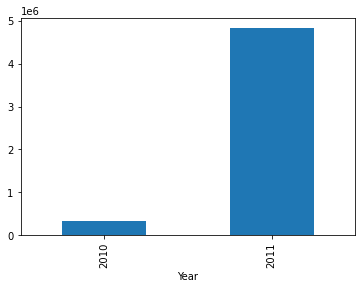

In [30]:
# Plot total products sold in each year
df.groupby('Year')['Quantity'].sum().plot(kind = 'bar') ## this is because have only 1 month data for 2010

#### We shall check the sales trend in detail, when performing feature engineering in later stages.


<AxesSubplot:title={'center':'Quantity sold month wise'}, xlabel='Mon,Year'>

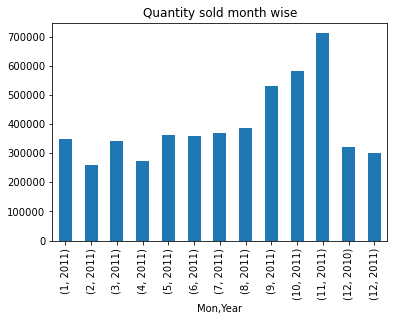

In [31]:
# Sales for different months

df['Mon'] = df['InvoiceDate'].dt.month
df['Month'] =df['InvoiceDate'].dt.month_name()
df.groupby(['Mon','Year'])['Quantity'].sum().plot(kind = 'bar', title = 'Quantity sold month wise')

Lets see the orders place based on the location country

In [76]:
df['Country'].value_counts() ### This indicates more than 90 % of data is United kingdom

United Kingdom          431987
Germany                   8093
France                    7700
EIRE                      7165
Netherlands               2225
Spain                     2209
Belgium                   1798
Switzerland               1781
Portugal                  1375
Australia                 1120
Norway                     978
Channel Islands            704
Italy                      695
Cyprus                     561
Finland                    533
Unspecified                409
Sweden                     409
Austria                    359
Denmark                    337
Japan                      305
Poland                     300
Israel                     267
Hong Kong                  251
Singapore                  199
USA                        167
Iceland                    162
Greece                     135
Canada                     126
Malta                       89
United Arab Emirates        66
RSA                         54
European Community          53
Lebanon 

In [47]:
figure = px.histogram(df, x = "Country",color_discrete_sequence= ["#ff6b00"])
figure.update_layout(
    plot_bgcolor = "#D4D4D4",
    paper_bgcolor = "#f6f5f5",
    xaxis = dict(
        title_text = "<b> Country </b>",
        titlefont = dict(size = 12),
        categoryorder = 'total descending'
    ),
    yaxis = dict(
        title_text = "<b>Total orders placed</b>",
        titlefont = dict(size = 12)
    ),
    title_text = "<b> Popular country to order online products </b>",
    title_font_size = 16,
    title_font_color = "black",
    title_pad_t = 5,
    title_pad_l = 20,
    )

figure.update_yaxes(showticklabels = True, showline = True, linewidth = 2, linecolor = "black")
figure.update_xaxes(showticklabels = True, showline = True, linewidth = 2, linecolor = "black")

figure.show()

In [31]:
#Create seperate dataframe for UK And non-uk

UK = df.loc[df["Country"] == "United Kingdom"]
Non_UK= df.loc[df["Country"] != "United Kingdom"]

In [42]:
Non_UK.shape

(40770, 10)

In [43]:
UK.shape

(431987, 10)

In [35]:
Prod_sold_uk = UK.groupby("Description").agg({
    "Quantity":"sum"
}).sort_values(by=['Quantity'], ascending=False).reset_index()
Prod_sold_uk[:10]

,Description,Quantity
0,"PAPER CRAFT , LITTLE BIRDIE",80995
1,MEDIUM CERAMIC TOP STORAGE JAR,77036
2,WORLD WAR 2 GLIDERS ASSTD DESIGNS,49430
3,POPCORN HOLDER,34726
4,ASSORTED COLOUR BIRD ORNAMENT,33636
5,PACK OF 12 LONDON TISSUES,25315
6,PACK OF 72 RETROSPOT CAKE CASES,24963
7,VICTORIAN GLASS HANGING T-LIGHT,23663
8,BROCADE RING PURSE,22768
9,ASSORTED COLOURS SILK FAN,21066


In [36]:
fig = px.bar(Prod_sold_uk[:20], x = "Description", y = "Quantity",
             color_discrete_sequence= ["#ff6b00"] * len(Prod_sold_uk)
            )
fig.update_layout(
        plot_bgcolor = "#ECECEC",
        title = "</b>Top 20 most ordered items in Uk</b>",
        yaxis_title = "Total Items",
        xaxis_title = "Item Description")

fig.show()

=========================================TEMP========================================

In [83]:
df.drop(['StockCode','UnitPrice','Month','Day of Week','Year','Mon','Country'],axis=1, inplace= True)

In [85]:
#Manually create the category based on desc
lst= ['DECOR','HOLDER','HLDR','BUNTING','BIRTHDAY','ORNAMENT','VINTAGE',' SIGN','WOODEN','FRAME','CANDLES',
      'CHRISTMAS','WATER','CLOCK','DOORMAT','HANG', 'HEART']
pattern = '|'.join(lst)
df.loc[df['Description'].str.contains(pattern),'Category']='Home Decor'

In [86]:
home_decor = df[df['Category']== 'Home Decor']

In [87]:
df= df[df['Category']!= 'Home Decor']

In [88]:
home_decor.drop(['Description'],axis=1, inplace= True)

In [98]:
home_decor.shape

(176066, 3)

In [93]:
df.shape

(296691, 4)

In [94]:
l1= ['PAPER', 'TISSUE', 'PEN', 'PENCIL','CHALK','Stationery','BOOK','NOTE']
pattern = '|'.join(l1)
df.loc[df['Description'].str.contains(pattern),'Category']='Stationary'

In [95]:
Stationery= df[df['Category']== 'Stationary']
df = df[df['Category']!= 'Stationary']

In [96]:
Stationery.drop(['Description'],axis=1, inplace= True)

In [97]:
Stationery.shape

(30429, 3)

In [99]:
l2= ['KITCHEN', 'FOOD','RECIPE','KNIFE','JAR','SPOONS','BOWL','PLATE','GLASS','LUNCH',
     'SNACK', 'TEA','MUG','FRYING','BAKING','NAPKIN','CAKE','JAM','PANTRY']
pattern = '|'.join(l2)
df.loc[df['Description'].str.contains(pattern),'Category']='Kitchen'


In [100]:
kitchen= df[df['Category']== 'Kitchen']
df = df[df['Category']!= 'Kitchen']

In [101]:
kitchen.drop(['Description'],axis=1, inplace= True)

In [102]:
kitchen.shape

(86784, 3)

In [103]:
L3= ['BULB', 'LIGHT', 'LANTERN', 'LAMP']
pattern = '|'.join(L3)
df.loc[df['Description'].str.contains(pattern),'Category']='Electrical and Lightings'

In [104]:
lights = df[df['Category']== 'Electrical and Lightings']
df = df[df['Category']!= 'Electrical and Lightings']

In [105]:
lights.drop(['Description'],axis=1, inplace= True)

In [106]:
lights.shape

(6848, 3)

In [107]:
L4= ['JUMBO','BAG']
pattern = '|'.join(L4)
df.loc[df['Description'].str.contains(pattern),'Category']='Storage/Laundry bags'

In [109]:
bags= df[df['Category']== 'Storage/Laundry bags']
df = df[df['Category']!= 'Storage/Laundry bags']

In [110]:
bags.drop(['Description'],axis=1, inplace= True)

In [111]:
home_decor.to_csv('home_decor.csv')
Stationery.to_csv('stationery.csv')
kitchen.to_csv('kitchen.csv')
lights.to_csv('electrical.csv')
bags.to_csv('bags.csv')

In [112]:
df[df['Description'].str.contains('PLAY',case= False)].sort_values(by=['Quantity'], ascending=False)

,Description,Quantity,InvoiceDate,Category
426634,MINI PLAYING CARDS GYMKHANA,800,2011-11-22 15:22:00,NaN
426633,MINI PLAYING CARDS BUFFALO BILL,800,2011-11-22 15:22:00,NaN
355706,MINI PLAYING CARDS BUFFALO BILL,500,2011-10-21 11:33:00,NaN
355707,MINI PLAYING CARDS SPACEBOY,500,2011-10-21 11:33:00,NaN
355708,MINI PLAYING CARDS FUN FAIR,500,2011-10-21 11:33:00,NaN
...,...,...,...,...
381303,POPPY'S PLAYHOUSE BEDROOM,1,2011-11-04 12:45:00,NaN
381304,POPPY'S PLAYHOUSE LIVINGROOM,1,2011-11-04 12:45:00,NaN
381457,PLAYING CARDS JUBILEE UNION JACK,1,2011-11-04 13:16:00,NaN
89390,POPPY'S PLAYHOUSE BEDROOM,1,2011-03-01 14:58:00,NaN


In [113]:
L5 = ['TOY','CHILD','DOLL','GIRL','SPACE','PLAY']
pattern = '|'.join(L5)
df.loc[df['Description'].str.contains(pattern),'Category']= 'Children Toys'

In [114]:
TOYS= df[df['Category']== 'Children Toys']
df = df[df['Category']!= 'Children Toys']

In [115]:
TOYS.drop(['Description'],axis=1, inplace= True)

In [116]:
TOYS.to_csv('toys.csv')

In [117]:
df.shape

(128457, 4)

## Category column using NLP techniques

In [63]:
#Stemming and make lower case
def stemSentence(sentence):
    porter = PorterStemmer()
    token_words = word_tokenize(sentence)
    stem_sentence = [porter.stem(word) for word in token_words]
    return ' '.join(stem_sentence)

txt3 = pd.Series([stemSentence(x) for x in txt2])

In [64]:
#Bag of words

vectorizer_cv = CountVectorizer(analyzer='word')
X_cv = vectorizer_cv.fit_transform(txt3)

In [65]:
# Show matrix

matrix= pd.concat([txt1, pd.DataFrame(X_cv.toarray(), columns=vectorizer_cv.get_feature_names())],axis=1)
matrix

MemoryError: Unable to allocate 6.50 GiB for an array with shape (1738, 502238) and data type float64

In [ ]:
#TF-IDF (n-gram level)

vectorizer_ntf = TfidfVectorizer(analyzer='word',ngram_range=(1,2))
X_ntf = vectorizer_ntf.fit_transform(txt3)